In [66]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

!pip install WordCloud
from wordcloud import WordCloud
from nltk.corpus import stopwords
from imblearn.over_sampling import SMOTE

import string

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import re
# To get diferent metric scores
from sklearn.metrics import (
    f1_score,
    accuracy_score,
    recall_score,
    precision_score,
    confusion_matrix,
    roc_auc_score,
    precision_recall_curve,
    roc_curve,
)

Defaulting to user installation because normal site-packages is not writeable


In [2]:
df = pd.read_csv("Tweets.csv")
pd.set_option('display.max_rows', None)

In [3]:
df.head(29)

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,airline_sentiment_gold,name,negativereason_gold,retweet_count,text,tweet_coord,tweet_created,tweet_location,user_timezone
0,5.703060e+17,neutral,1.0000,NaN,NaN,Virgin America,NaN,cairdin,NaN,0,@VirginAmerica What @dhepburn said.,NaN,2015-02-24 11:35:52 -0800,NaN,Eastern Time (US & Canada)
1,5.703010e+17,positive,0.3486,NaN,0.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica plus you've added commercials t...,NaN,2015-02-24 11:15:59 -0800,NaN,Pacific Time (US & Canada)
2,5.703010e+17,neutral,0.6837,NaN,NaN,Virgin America,NaN,yvonnalynn,NaN,0,@VirginAmerica I didn't today... Must mean I n...,NaN,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,5.703010e+17,negative,1.0000,Bad Flight,0.7033,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica it's really aggressive to blast...,NaN,2015-02-24 11:15:36 -0800,NaN,Pacific Time (US & Canada)
4,5.703010e+17,negative,1.0000,Can't Tell,1.0000,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica and it's a really big bad thing...,NaN,2015-02-24 11:14:45 -0800,NaN,Pacific Time (US & Canada)
5,5.703010e+17,negative,1.0000,Can't Tell,0.6842,Virgin America,NaN,jnardino,NaN,0,@VirginAmerica seriously would pay $30 a fligh...,NaN,2015-02-24 11:14:33 -0800,NaN,Pacific Time (US & Canada)
6,5.703010e+17,positive,0.6745,NaN,0.0000,Virgin America,NaN,cjmcginnis,NaN,0,"@VirginAmerica yes, nearly every time I fly VX...",NaN,2015-02-24 11:13:57 -0800,San Francisco CA,Pacific Time (US & Canada)
7,5.703000e+17,neutral,0.6340,NaN,NaN,Virgin America,NaN,pilot,NaN,0,@VirginAmerica Really missed a prime opportuni...,NaN,2015-02-24 11:12:29 -0800,Los Angeles,Pacific Time (US & Canada)
8,5.703000e+17,positive,0.6559,NaN,NaN,Virgin America,NaN,dhepburn,NaN,0,"@virginamerica Well, I didn't…but NOW I DO! :-D",NaN,2015-02-24 11:11:19 -0800,San Diego,Pacific Time (US & Canada)
9,5.702950e+17,positive,1.0000,NaN,NaN,Virgin America,NaN,YupitsTate,NaN,0,"@VirginAmerica it was amazing, and arrived an ...",NaN,2015-02-24 10:53:27 -0800,Los Angeles,Eastern Time (US & Canada)


In [4]:
df.columns

Index(['tweet_id', 'airline_sentiment', 'airline_sentiment_confidence',
       'negativereason', 'negativereason_confidence', 'airline',
       'airline_sentiment_gold', 'name', 'negativereason_gold',
       'retweet_count', 'text', 'tweet_coord', 'tweet_created',
       'tweet_location', 'user_timezone'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14640 entries, 0 to 14639
Data columns (total 15 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   tweet_id                      14640 non-null  float64
 1   airline_sentiment             14640 non-null  object 
 2   airline_sentiment_confidence  14640 non-null  float64
 3   negativereason                9178 non-null   object 
 4   negativereason_confidence     10522 non-null  float64
 5   airline                       14640 non-null  object 
 6   airline_sentiment_gold        40 non-null     object 
 7   name                          14640 non-null  object 
 8   negativereason_gold           32 non-null     object 
 9   retweet_count                 14640 non-null  int64  
 10  text                          14640 non-null  object 
 11  tweet_coord                   1019 non-null   object 
 12  tweet_created                 14640 non-null  object 
 13  t

In [6]:
missing_values = pd.DataFrame(df.isna().sum()/df.shape[0] * 100,columns=['Values'])
missing_values

,Values
tweet_id,0.000000
airline_sentiment,0.000000
airline_sentiment_confidence,0.000000
negativereason,37.308743
negativereason_confidence,28.128415
airline,0.000000
airline_sentiment_gold,99.726776
name,0.000000
negativereason_gold,99.781421
retweet_count,0.000000


Text(0.5, 1.0, 'Missing Count Plot')

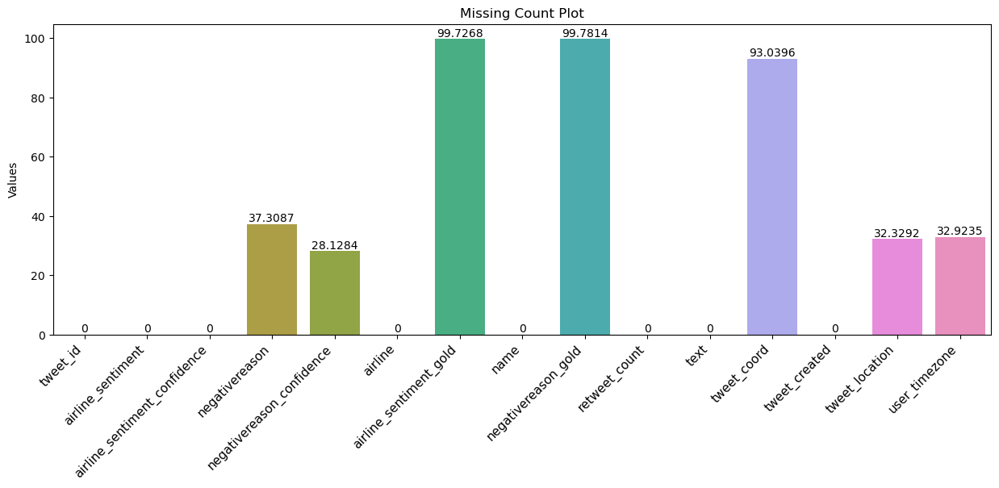

In [7]:
plt.figure(figsize=(15,5))
a = sns.barplot(x=missing_values.index, y=missing_values['Values'])
for i in a.containers:
    a.bar_label(i,)
a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=11)
a.set_title('Missing Count Plot')

In [8]:
df['airline_sentiment_gold'].value_counts()

negative    32
positive     5
neutral      3
Name: airline_sentiment_gold, dtype: int64

In [9]:
#checking missing values of airline_sentiment_gold
df[df['airline_sentiment_gold'].isna() == False]['airline_sentiment'].value_counts()

negative    32
positive     5
neutral      3
Name: airline_sentiment, dtype: int64

In [10]:
df['negativereason_gold'].value_counts()

Customer Service Issue                      12
Late Flight                                  4
Can't Tell                                   3
Cancelled Flight                             3
Cancelled Flight\nCustomer Service Issue     2
Late Flight\nFlight Attendant Complaints     1
Late Flight\nLost Luggage                    1
Bad Flight                                   1
Lost Luggage\nDamaged Luggage                1
Late Flight\nCancelled Flight                1
Flight Attendant Complaints                  1
Customer Service Issue\nLost Luggage         1
Customer Service Issue\nCan't Tell           1
Name: negativereason_gold, dtype: int64

In [11]:
#checking missing values of negativereason_gold
df[df['negativereason_gold'].isna() == False]['airline_sentiment'].value_counts()

negative    32
Name: airline_sentiment, dtype: int64

In [12]:
df.drop(columns=['airline_sentiment_gold','negativereason_gold','tweet_coord'],inplace=True)

In [13]:
df.isna().sum()/df.shape[0] * 100

tweet_id                         0.000000
airline_sentiment                0.000000
airline_sentiment_confidence     0.000000
negativereason                  37.308743
negativereason_confidence       28.128415
airline                          0.000000
name                             0.000000
retweet_count                    0.000000
text                             0.000000
tweet_created                    0.000000
tweet_location                  32.329235
user_timezone                   32.923497
dtype: float64

In [14]:
#checking missing values of negativereason
df[df['negativereason'].isna() == True]['airline_sentiment'].value_counts()

neutral     3099
positive    2363
Name: airline_sentiment, dtype: int64

As we can see all neutral and positive sentiments values are missing details in negativereason we are replacing thoes missing value with NA 

In [15]:
filtered_values = np.where(df['negativereason'].isna() == True)
print(df.loc[filtered_values]['airline_sentiment'].value_counts().sum())
df.loc[df['negativereason'].isna() == True,'negativereason'] = 'NA'

5462


In [16]:
#checking missing values of negativereason
df[df['negativereason_confidence'].isna() == True]['airline_sentiment'].value_counts()

neutral     2085
positive    2033
Name: airline_sentiment, dtype: int64

In [17]:
filtered_values = np.where(df['negativereason_confidence'].isna() == True)
print(df.loc[filtered_values]['airline_sentiment'].value_counts().sum())
df.loc[df['negativereason_confidence'].isna() == True,'negativereason_confidence'] = 0.0

4118


As we can see all neutral and positive sentiments values are missing details in negativereason_confidence we are replacing thoes missing value with 0.0

In [18]:
df.isna().sum()/df.shape[0] * 100

tweet_id                         0.000000
airline_sentiment                0.000000
airline_sentiment_confidence     0.000000
negativereason                   0.000000
negativereason_confidence        0.000000
airline                          0.000000
name                             0.000000
retweet_count                    0.000000
text                             0.000000
tweet_created                    0.000000
tweet_location                  32.329235
user_timezone                   32.923497
dtype: float64

In [19]:
df[df['tweet_location'].isna() == True]['user_timezone'].value_counts()

Eastern Time (US & Canada)     701
Central Time (US & Canada)     365
Quito                          220
Pacific Time (US & Canada)     215
Atlantic Time (Canada)         177
Arizona                         65
Mountain Time (US & Canada)     62
London                          47
Alaska                          46
Hawaii                          30
Amsterdam                       20
Paris                            9
Dublin                           9
Buenos Aires                     9
Mid-Atlantic                     6
Athens                           5
Sydney                           5
Brussels                         5
America/New_York                 4
Bogota                           4
Casablanca                       4
America/Chicago                  3
Santiago                         3
New Caledonia                    3
Indiana (East)                   3
Beijing                          3
Kyiv                             2
Brasilia                         2
Central America     

In [20]:
df[df['user_timezone'].isna() == True]['airline_sentiment'].value_counts()

negative    3170
neutral      971
positive     679
Name: airline_sentiment, dtype: int64

In [21]:
filtered_values = np.where((df['user_timezone'].isna() == True) & (df['tweet_location'].isna() == True))
print(df.loc[filtered_values]['airline_sentiment'].value_counts().sum())

2671


In [22]:
df.fillna('Other',inplace=True)

In [23]:
df.isna().sum()/df.shape[0] * 100

tweet_id                        0.0
airline_sentiment               0.0
airline_sentiment_confidence    0.0
negativereason                  0.0
negativereason_confidence       0.0
airline                         0.0
name                            0.0
retweet_count                   0.0
text                            0.0
tweet_created                   0.0
tweet_location                  0.0
user_timezone                   0.0
dtype: float64

In [24]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
tweet_id,14640.0,NaN,NaN,NaN,569218350614754048.0,779109221830024.0,567588000000000000.0,568559000000000000.0,569478000000000000.0,569890250000000000.0,570311000000000000.0
airline_sentiment,14640,3,negative,9178,NaN,NaN,NaN,NaN,NaN,NaN,NaN
airline_sentiment_confidence,14640.0,NaN,NaN,NaN,0.900169,0.16283,0.335,0.6923,1.0,1.0,1.0
negativereason,14640,11,NA,5462,NaN,NaN,NaN,NaN,NaN,NaN,NaN
negativereason_confidence,14640.0,NaN,NaN,NaN,0.458755,0.401057,0.0,0.0,0.6246,0.7033,1.0
airline,14640,6,United,3822,NaN,NaN,NaN,NaN,NaN,NaN,NaN
name,14640,7701,JetBlueNews,63,NaN,NaN,NaN,NaN,NaN,NaN,NaN
retweet_count,14640.0,NaN,NaN,NaN,0.08265,0.745778,0.0,0.0,0.0,0.0,44.0
text,14640,14427,@united thanks,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN
tweet_created,14640,14247,2015-02-24 09:54:34 -0800,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
df.duplicated().sum()

39

In [26]:
df[df.duplicated() == True]

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone
12040,5.703080e+17,negative,1.0,Customer Service Issue,1.0,American,SweeLoTmac,0,@AmericanAir why would I even consider continu...,2015-02-24 11:44:31 -0800,Other,Quito
12059,5.703050e+17,neutral,1.0,NA,0.0,American,Chandrafaythe,0,@AmericanAir my flight got Cancelled Flightled...,2015-02-24 11:31:34 -0800,Other,Quito
12063,5.703030e+17,neutral,1.0,NA,0.0,American,trentgillaspie,0,.@AmericanAir just disappointed with the Fligh...,2015-02-24 11:24:57 -0800,"Austin, but often Denver",Mountain Time (US & Canada)
12066,5.703020e+17,neutral,1.0,NA,0.0,American,FinEdChat,0,@AmericanAir I did,2015-02-24 11:19:10 -0800,"Cincinnati, Ohio",Atlantic Time (Canada)
12068,5.703010e+17,negative,1.0,Late Flight,1.0,American,JoBarredaV,1,@AmericanAir r u serious?? 304min #delay with ...,2015-02-24 11:17:02 -0800,Mexico City,Central Time (US & Canada)
12069,5.703010e+17,negative,1.0,Cancelled Flight,1.0,American,LancasterPattie,0,@AmericanAir You are jumping the gun and Cance...,2015-02-24 11:15:08 -0800,Other,Other
12074,5.702990e+17,positive,1.0,NA,0.0,American,Mtts28,0,@AmericanAir This is exactly why ill be flying...,2015-02-24 11:08:32 -0800,Virginia,Eastern Time (US & Canada)
12075,5.702990e+17,negative,1.0,Customer Service Issue,1.0,American,law_econ,0,@AmericanAir This doesn't address my issue. I ...,2015-02-24 11:06:37 -0800,"Newport Beach, CA",Central Time (US & Canada)
12078,5.702990e+17,negative,1.0,Customer Service Issue,1.0,American,denismishin,0,@AmericanAir submitted a case to AA customer r...,2015-02-24 11:06:07 -0800,"Bellevue, WA",Eastern Time (US & Canada)
12079,5.702980e+17,negative,1.0,Late Flight,1.0,American,djjohnpayne,0,@AmericanAir if by near the gate you mean sitt...,2015-02-24 11:05:01 -0800,"Las Vegas, NV",Pacific Time (US & Canada)


In [27]:
df = df.drop_duplicates()

## EDA

### Univariate

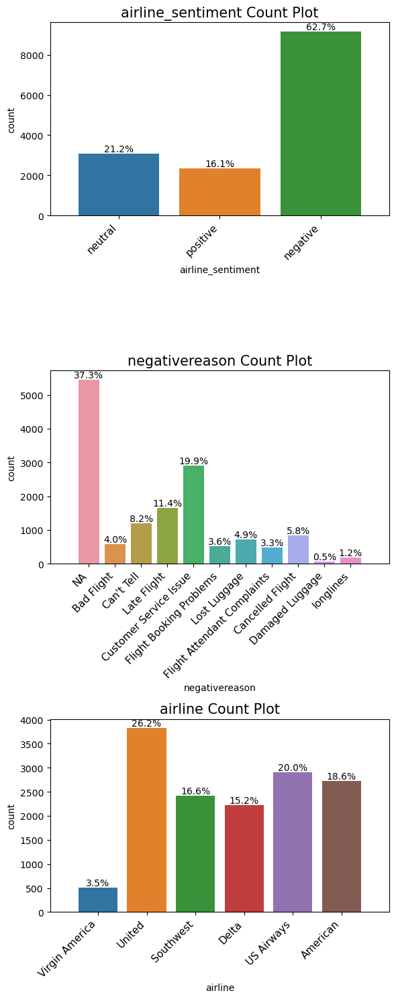

In [28]:
## Univariate catagory column
lstctg = ['airline_sentiment','negativereason', 'airline']
fig, axes = plt.subplots(nrows= len(lstctg),ncols=1)
fig.set_size_inches(6, 5*len(lstctg))
index = 0;
for i in lstctg:
    a = sns.countplot(x=df[i], ax=axes[index])
    # get the total count of the type column
    total = df[i].count()
    # annotate the bars with fmt from matplotlib v3.7.0
    a.bar_label(a.containers[0], fmt=lambda x: f'{(x/total)*100:0.1f}%')
    # add space at the end of the bar for the labels
    a.margins(x=0.1)
    a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=11)
    a.set_title(i + ' Count Plot',fontsize=15)
    index = index+1
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Airline Senitiments')

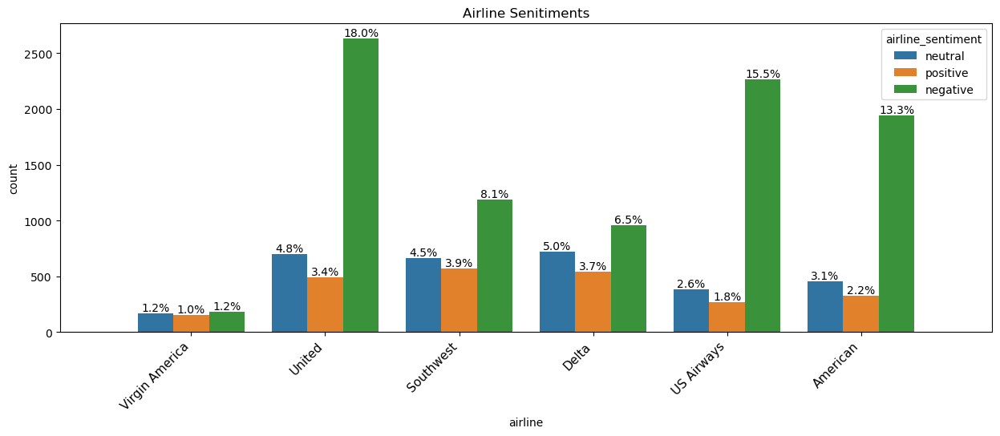

In [29]:
plt.figure(figsize=(15,5))
a = sns.countplot(df,x='airline', hue='airline_sentiment')
total = df['airline'].count()
# annotate the bars with fmt from matplotlib v3.7.0
for i in a.containers:
    a.bar_label(i, fmt=lambda x: f'{(x/total)*100:0.1f}%')
# a.bar_label(a.containers[0], fmt=lambda x: f'{(x/total)*100:0.1f}%')
# add space at the end of the bar for the labels
a.margins(x=0.1)
a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=11)
a.set_title('Airline Senitiments')

Text(0.5, 1.0, 'Negative Reason Count Plot')

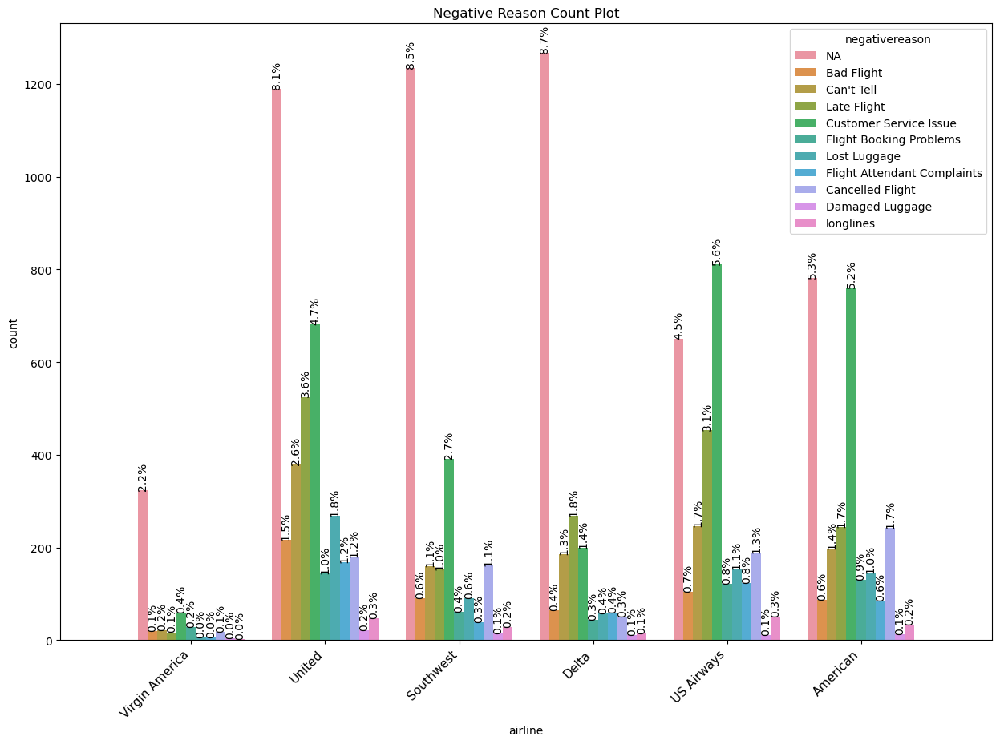

In [30]:
plt.figure(figsize=(15,10))
a = sns.countplot(df,x='airline', hue='negativereason')
total = df['airline'].count()
# annotate the bars with fmt from matplotlib v3.7.0
for i in a.containers:
    a.bar_label(i, fmt=lambda x: f'{(x/total)*100:0.1f}%',rotation=90)
# a.bar_label(a.containers[0], fmt=lambda x: f'{(x/total)*100:0.1f}%')
# add space at the end of the bar for the labels
a.margins(x=0.1)
a.set_xticklabels(a.get_xticklabels(), rotation=45, horizontalalignment='right', fontsize=11)
a.set_title('Negative Reason Count Plot')

In [31]:
df.columns

Index(['tweet_id', 'airline_sentiment', 'airline_sentiment_confidence',
       'negativereason', 'negativereason_confidence', 'airline', 'name',
       'retweet_count', 'text', 'tweet_created', 'tweet_location',
       'user_timezone'],
      dtype='object')

In [32]:
location_sentiments = pd.DataFrame(df[df['airline_sentiment'] == 'negative'].groupby(['tweet_location','airline'])['negativereason'].value_counts())

print(location_sentiments)

                                                                               negativereason
tweet_location                     airline        negativereason                             
 DC | Jersey City                  Virgin America Customer Service Issue                    1
 Los Angeles                       American       Can't Tell                                1
 Mexico, D.F.                      US Airways     Late Flight                               3
 NASHVILLE,TN                      Southwest      Customer Service Issue                    1
 NYC                               American       Late Flight                               1
 Ole Miss • ATL                    Southwest      Customer Service Issue                    1
#BrownsNation                      Southwest      Bad Flight                                1
#ManorvilleInExile                 Delta          Customer Service Issue                    1
                                                  Flight Boo

In [33]:
timezon_sentiments = pd.DataFrame(df[df['airline_sentiment'] == 'negative'].groupby(['user_timezone','airline'])['negativereason'].value_counts())

print(timezon_sentiments)

                                                                        negativereason
user_timezone               airline        negativereason                             
Adelaide                    US Airways     Customer Service Issue                    1
                                           Flight Booking Problems                   1
Alaska                      American       Customer Service Issue                   15
                                           Cancelled Flight                          7
                                           Can't Tell                                2
                                           Flight Attendant Complaints               2
                                           Late Flight                               2
                            Delta          Customer Service Issue                    2
                                           Late Flight                               2
                            Southwest      

In [34]:
timezon_location = pd.DataFrame(df.groupby(['user_timezone','tweet_location'])['airline_sentiment'].value_counts())

print(timezon_location)

                                                                                  airline_sentiment
user_timezone               tweet_location                     airline_sentiment                   
Abu Dhabi                   Abu Dhabi                          neutral                           12
                            Algiers, Algeria                   neutral                            1
                            Russia, Россия                     positive                          10
Adelaide                    Adelaide, Australia                negative                           1
                            Adelaide, South Australia          neutral                            2
                                                               positive                           1
                            Melbourne, Australia               negative                           1
                                                               neutral                            1


West Central Africa         Other                              negative                           1


In [35]:
name_location = pd.DataFrame(df.groupby(['name','tweet_location'])['airline_sentiment'].value_counts())

print(name_location)

                                                                          airline_sentiment
name                tweet_location                     airline_sentiment                   
0504Traveller       Other                              neutral                            5
0veranalyser        Other                              negative                           2
0xjared             BOS via ROC                        neutral                            1
10Eshaa             St. John's                         neutral                            1
1234567890_         Boulder, CO | Los Angeles, CA      negative                           1
                                                       positive                           1
140JustinC          Fredericton NB                     neutral                            4
                                                       negative                           1
18handicap          anywhere but CStat                 neutral                  

In [36]:
print(df.retweet_count.value_counts())
reTweetData = pd.DataFrame(df[df.retweet_count >= 2].groupby(['negativereason','airline','user_timezone'])['retweet_count'].value_counts())
reTweetData

0     13835
1       639
2        66
3        22
4        17
5         5
7         3
6         3
22        2
8         1
32        1
28        1
9         1
18        1
11        1
31        1
15        1
44        1
Name: retweet_count, dtype: int64


retweet_count
negativereason              airline        user_timezone               retweet_count               
Bad Flight                  Delta          Eastern Time (US & Canada)  2                          1
                            US Airways     Other                       3                          1
                            United         Other                       3                          1
                                           Pacific Time (US & Canada)  2                          1
Can't Tell                  American       Eastern Time (US & Canada)  4                          1
                                           Other                       3                          1
                                           Quito                       2                          1
                            Delta          Central Time (US & Canada)  3                          1
                                           Eastern Time (US & Canada)  22                         1
                                           Other                       31                         1
                                           Pacific Time (US & Canada)  18                         1
                                           Quito                       7                          1
                            Southwest      Central Time (US & Canada)  2                          1
                                           Eastern Time (US & Canada)  2                          1
                                           Other                       3                          1
                                                                       4                          1
                            US Airways     Eastern Time (US & Canada)  32                         1
                                           Other                       4                          1
                            United         Other                       2                          1
                                                                       3                          1
                                           Pacific Time (US & Canada)  3                          1
Cancelled Flight            American       Eastern Time (US & Canada)  4                          2
                                                                       5                          1
                            Delta          Pacific Time (US & Canada)  2                          1
                            Southwest      Central Time (US & Canada)  3                          1
                                           Eastern Time (US & Canada)  2                          3
                            US Airways     Eastern Time (US & Canada)  2                          1
                            United         Other                       2                          1
                                           Pacific Time (US & Canada)  2                          1
Customer Service Issue      American       Central Time (US & Canada)  3                          1
                                           Eastern Time (US & Canada)  2                          3
                                                                       4                          2
                                           Other                       2                          1
                                           Pacific Time (US & Canada)  2                          1
                            Delta          Eastern Time (US & Canada)  2                          1
                                           Other                       3                          1
                            Southwest      Central Time (US & Canada)  2                          1
                                           Mountain Time (US & Canada) 4                          1
                                           Other                       2              

In [37]:
df

,tweet_id,airline_sentiment,airline_sentiment_confidence,negativereason,negativereason_confidence,airline,name,retweet_count,text,tweet_created,tweet_location,user_timezone
0,5.703060e+17,neutral,1.0000,NA,0.0000,Virgin America,cairdin,0,@VirginAmerica What @dhepburn said.,2015-02-24 11:35:52 -0800,Other,Eastern Time (US & Canada)
1,5.703010e+17,positive,0.3486,NA,0.0000,Virgin America,jnardino,0,@VirginAmerica plus you've added commercials t...,2015-02-24 11:15:59 -0800,Other,Pacific Time (US & Canada)
2,5.703010e+17,neutral,0.6837,NA,0.0000,Virgin America,yvonnalynn,0,@VirginAmerica I didn't today... Must mean I n...,2015-02-24 11:15:48 -0800,Lets Play,Central Time (US & Canada)
3,5.703010e+17,negative,1.0000,Bad Flight,0.7033,Virgin America,jnardino,0,@VirginAmerica it's really aggressive to blast...,2015-02-24 11:15:36 -0800,Other,Pacific Time (US & Canada)
4,5.703010e+17,negative,1.0000,Can't Tell,1.0000,Virgin America,jnardino,0,@VirginAmerica and it's a really big bad thing...,2015-02-24 11:14:45 -0800,Other,Pacific Time (US & Canada)
5,5.703010e+17,negative,1.0000,Can't Tell,0.6842,Virgin America,jnardino,0,@VirginAmerica seriously would pay $30 a fligh...,2015-02-24 11:14:33 -0800,Other,Pacific Time (US & Canada)
6,5.703010e+17,positive,0.6745,NA,0.0000,Virgin America,cjmcginnis,0,"@VirginAmerica yes, nearly every time I fly VX...",2015-02-24 11:13:57 -0800,San Francisco CA,Pacific Time (US & Canada)
7,5.703000e+17,neutral,0.6340,NA,0.0000,Virgin America,pilot,0,@VirginAmerica Really missed a prime opportuni...,2015-02-24 11:12:29 -0800,Los Angeles,Pacific Time (US & Canada)
8,5.703000e+17,positive,0.6559,NA,0.0000,Virgin America,dhepburn,0,"@virginamerica Well, I didn't…but NOW I DO! :-D",2015-02-24 11:11:19 -0800,San Diego,Pacific Time (US & Canada)
9,5.702950e+17,positive,1.0000,NA,0.0000,Virgin America,YupitsTate,0,"@VirginAmerica it was amazing, and arrived an ...",2015-02-24 10:53:27 -0800,Los Angeles,Eastern Time (US & Canada)


In [38]:
df['Timestamp'] = pd.to_datetime(df['tweet_created'])
df['Date'] = df['Timestamp'].dt.date
grouped = df.groupby(by='Date')['airline_sentiment'].value_counts()
grouped

Date        airline_sentiment
2015-02-16  negative                3
            neutral                 1
2015-02-17  negative              838
            neutral               297
            positive              273
2015-02-18  negative              736
            neutral               335
            positive              273
2015-02-19  negative              751
            neutral               329
            positive              296
2015-02-20  negative              835
            neutral               383
            positive              282
2015-02-21  negative             1049
            neutral               278
            positive              230
2015-02-22  negative             2264
            neutral               463
            positive              350
2015-02-23  negative             1919
            neutral               676
            positive              433
2015-02-24  negative              762
            neutral               329
            positive

In [39]:
unstacked = grouped.unstack(level=1)

<Axes: xlabel='Date'>

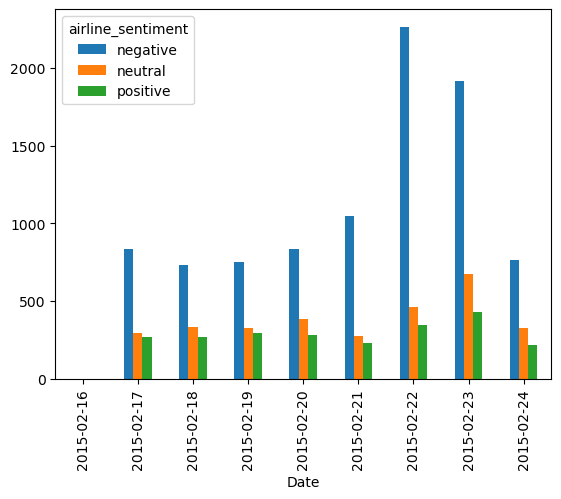

In [40]:
unstacked.plot.bar()

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14601 entries, 0 to 14639
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype                                 
---  ------                        --------------  -----                                 
 0   tweet_id                      14601 non-null  float64                               
 1   airline_sentiment             14601 non-null  object                                
 2   airline_sentiment_confidence  14601 non-null  float64                               
 3   negativereason                14601 non-null  object                                
 4   negativereason_confidence     14601 non-null  float64                               
 5   airline                       14601 non-null  object                                
 6   name                          14601 non-null  object                                
 7   retweet_count                 14601 non-null  int64                         

In [42]:
# droping tweet_id,name,tweet_location Timestamp, Date and tweet_created as it do not 
df.drop(columns=['tweet_id', 'name', 'tweet_location', 'tweet_created','Timestamp','Date'], inplace=True)

### change data type object to str

In [43]:
df['text'] = df['text'].astype('string')

## Cleaning the Raw Data

In [50]:
# Remove stop words
def remove_stopwords(text):
    text = ' '.join([word for word in text.split() if word not in (stopwords.words('english'))])
    return text

# Remove url  
def remove_url(text):
    url = re.compile(r'https?://\S+|www\.\S+')
    return url.sub(r'',text)

# Remove punct
def remove_punct(text):
    table = str.maketrans('', '', string.punctuation)
    return text.translate(table)

# Remove html 
def remove_html(text):
    html=re.compile(r'<.*?>')
    return html.sub(r'',text)

# Remove @username
def remove_username(text):
    return re.sub('@[^\s]+','',text)

# Remove emojis
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)


# Decontraction text
def decontraction(text):
    text = re.sub(r"won\'t", " will not", text)
    text = re.sub(r"won\'t've", " will not have", text)
    text = re.sub(r"can\'t", " can not", text)
    text = re.sub(r"don\'t", " do not", text)
    
    text = re.sub(r"can\'t've", " can not have", text)
    text = re.sub(r"ma\'am", " madam", text)
    text = re.sub(r"let\'s", " let us", text)
    text = re.sub(r"ain\'t", " am not", text)
    text = re.sub(r"shan\'t", " shall not", text)
    text = re.sub(r"sha\n't", " shall not", text)
    text = re.sub(r"o\'clock", " of the clock", text)
    text = re.sub(r"y\'all", " you all", text)
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"n\'t've", " not have", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'d've", " would have", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'ll've", " will have", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    text = re.sub(r"\'re", " are", text)
    return text  

# Seperate alphanumeric
def seperate_alphanumeric(text):
    words = text
    words = re.findall(r"[^\W\d_]+|\d+", words)
    return " ".join(words)

def cont_rep_char(text):
    tchr = text.group(0) 
    
    if len(tchr) > 1:
        return tchr[0:2] 

def unique_char(rep, text):
    substitute = re.sub(r'(\w)\1+', rep, text)
    return substitute

def char(text):
    substitute = re.sub(r'[^a-zA-Z]',' ',text)
    return substitute

# combaine negative reason with  tweet (if exsist)
df['final_text'] = df['negativereason'].fillna('') + ' ' + df['text'] 


# Apply functions on tweets
df['final_text'] = df['final_text'].apply(lambda x : remove_username(x))
df['final_text'] = df['final_text'].apply(lambda x : remove_url(x))
df['final_text'] = df['final_text'].apply(lambda x : remove_emoji(x))
df['final_text'] = df['final_text'].apply(lambda x : decontraction(x))
df['final_text'] = df['final_text'].apply(lambda x : seperate_alphanumeric(x))
df['final_text'] = df['final_text'].apply(lambda x : unique_char(cont_rep_char,x))
df['final_text'] = df['final_text'].apply(lambda x : char(x))
df['final_text'] = df['final_text'].apply(lambda x : x.lower())
df['final_text'] = df['final_text'].apply(lambda x : remove_stopwords(x))

In [51]:
# result
df['final_text']

0                                                  na said
1               na plus added commercials experience tacky
2                na today must mean need take another trip
3        bad flight really aggressive blast obnoxious e...
4                             ca tell really big bad thing
5        ca tell seriously would pay flight seats playi...
6         na yes nearly every time fly vx ear worm go away
7        na really missed prime opportunity men without...
8                                                  na well
9                       na amazing arrived hour early good
10       na know suicide second leading cause death amo...
11       na lt pretty graphics much better minimal icon...
12       na great deal already thinking nd trip amp eve...
13       na flying fabulous seductive skies u take stre...
14                                               na thanks
15                  late flight sfo pdx schedule still mia
16       na excited first cross country flight lax mco .

In [57]:
df['text'] = df['final_text']
df.drop(columns=['final_text','negativereason'],inplace=True)

### Word cloud

In [53]:
positive=df[df['airline_sentiment']=='positive'].text
neutral=df[df['airline_sentiment']=='neutral'].text
negative=df[df['airline_sentiment']=='negative'].text

### Positive sentiment word cloud

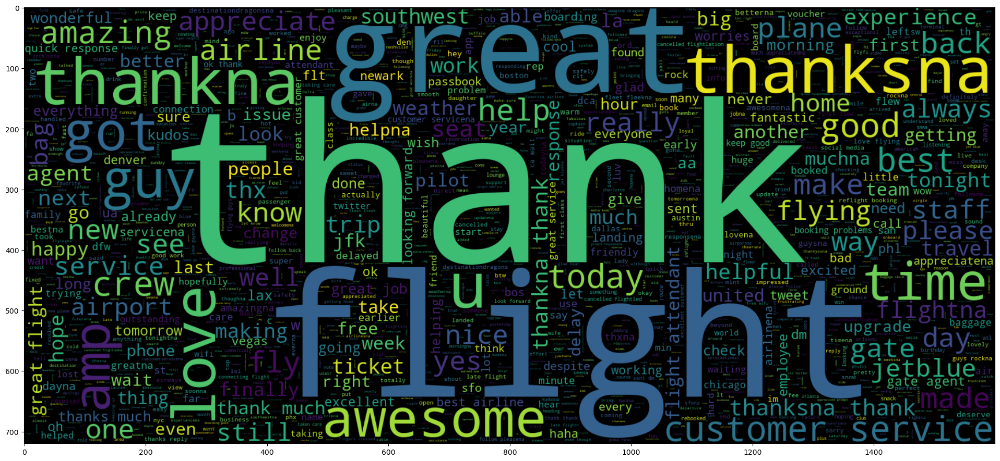

In [54]:
plt.figure(figsize=(24,20))
world_cloud_postive=WordCloud(min_font_size=3,max_words=3200,width=1600,height=720).generate("".join(positive))
plt.imshow(world_cloud_postive,interpolation='bilinear')

### Neutral sentiment word cloud

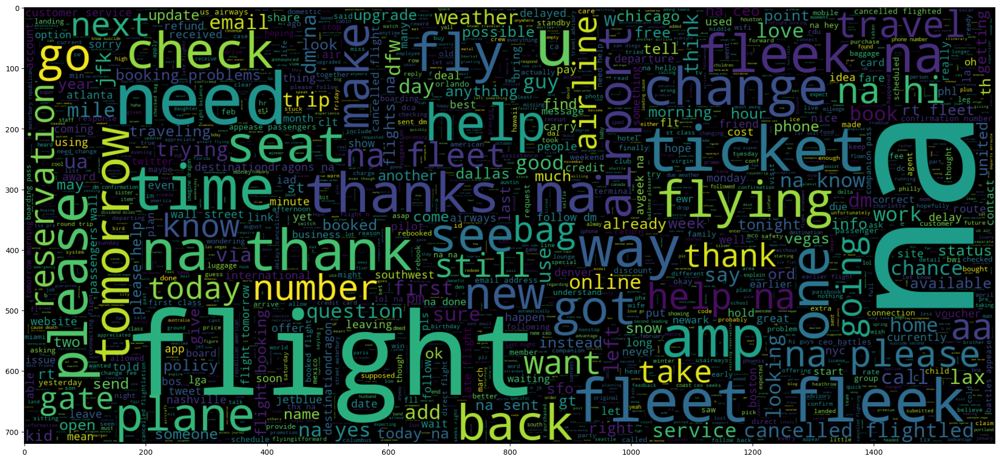

In [55]:
plt.figure(figsize=(24,12))
world_cloud_neutral=WordCloud(min_font_size=3,max_words=3200,width=1600,height=720).generate(" ".join(neutral))
plt.imshow(world_cloud_neutral,interpolation='bilinear')

### Negative sentiment word cloud

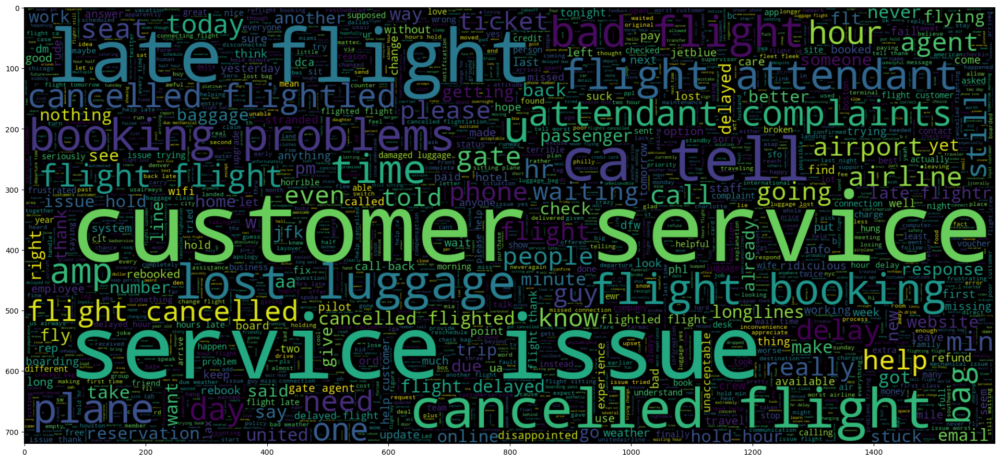

In [56]:
plt.figure(figsize = (24,12)) 
worldcould_neg = WordCloud(min_font_size = 3,  max_words = 3200 , width = 1600 , height = 720).generate(" ".join(negative))
plt.imshow(worldcould_neg,interpolation = 'bilinear')

In [58]:
df_copy = df.copy()

### Label encoding

In [59]:
sentiments = {'negative':-1, 'neutral':0, 'positive':1}
df_copy['airline_sentiment'] = df_copy['airline_sentiment'].map(sentiments)
df_copy.airline_sentiment.value_counts()

-1    9157
 0    3091
 1    2353
Name: airline_sentiment, dtype: int64

In [60]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14601 entries, 0 to 14639
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   airline_sentiment             14601 non-null  int64  
 1   airline_sentiment_confidence  14601 non-null  float64
 2   negativereason_confidence     14601 non-null  float64
 3   airline                       14601 non-null  object 
 4   retweet_count                 14601 non-null  int64  
 5   text                          14601 non-null  object 
 6   user_timezone                 14601 non-null  object 
dtypes: float64(2), int64(2), object(3)
memory usage: 912.6+ KB


In [61]:
lst_object = ['airline','user_timezone']
for i in lst_object:
    data = pd.get_dummies(df_copy[i], prefix=i, drop_first= True)
    df_copy = pd.concat([df_copy,data],axis=1)

df_copy.drop(columns=lst_object,inplace=True)

In [62]:
df_copy.head()

,airline_sentiment,airline_sentiment_confidence,negativereason_confidence,retweet_count,text,airline_Delta,airline_Southwest,airline_US Airways,airline_United,airline_Virgin America,...,user_timezone_Stockholm,user_timezone_Sydney,user_timezone_Taipei,user_timezone_Tehran,user_timezone_Tijuana,user_timezone_Tokyo,user_timezone_Vienna,user_timezone_Warsaw,user_timezone_Wellington,user_timezone_West Central Africa
0,0,1.0000,0.0000,0,na said,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1,1,0.3486,0.0000,0,na plus added commercials experience tacky,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2,0,0.6837,0.0000,0,na today must mean need take another trip,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
3,-1,1.0000,0.7033,0,bad flight really aggressive blast obnoxious e...,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,-1,1.0000,1.0000,0,ca tell really big bad thing,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [63]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14601 entries, 0 to 14639
Data columns (total 95 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   airline_sentiment                          14601 non-null  int64  
 1   airline_sentiment_confidence               14601 non-null  float64
 2   negativereason_confidence                  14601 non-null  float64
 3   retweet_count                              14601 non-null  int64  
 4   text                                       14601 non-null  object 
 5   airline_Delta                              14601 non-null  uint8  
 6   airline_Southwest                          14601 non-null  uint8  
 7   airline_US Airways                         14601 non-null  uint8  
 8   airline_United                             14601 non-null  uint8  
 9   airline_Virgin America                     14601 non-null  uint8  
 10  user_timezone_Adelaide

### Train Test split

In [83]:
X = df_copy.drop(["airline_sentiment"], axis=1)
Y = df_copy["airline_sentiment"]

# Splitting data in train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.30, random_state=1)

print("Shape of Training set : ", X_train.shape)
print("Shape of test set : ", X_test.shape)
print("Percentage of classes in training set:")
print(y_train.value_counts(normalize=True))
print("Percentage of classes in test set:")
print(y_test.value_counts(normalize=True))

Shape of Training set :  (10220, 94)
Shape of test set :  (4381, 94)
Percentage of classes in training set:
-1    0.628865
 0    0.210665
 1    0.160470
Name: airline_sentiment, dtype: float64
Percentage of classes in test set:
-1    0.623145
 0    0.214106
 1    0.162748
Name: airline_sentiment, dtype: float64


### TF-IDF Transformation

TF-IDF stands for “term frequency-inverse document frequency” – a statistical measure that tells us how relevant a word is to a document in a collection. In simpler terms, it converts words into a vector of numbers where each word has its own numeric representation

In [84]:
tfidf = TfidfVectorizer(strip_accents=None,lowercase=False,preprocessor=None)
data_train = tfidf.fit_transform(X_train['text'])
data_test = tfidf.transform(X_test['text'])

data_train = pd.DataFrame(data_train.toarray(), columns=tfidf.get_feature_names_out())
data_test = pd.DataFrame(data_test.toarray(), columns=tfidf.get_feature_names_out())

X_train.reset_index(drop=True, inplace=True)
data_train.reset_index(drop=True, inplace=True)

X_test.reset_index(drop=True, inplace=True)
data_test.reset_index(drop=True, inplace=True)

X_train = pd.concat([X_train,data_train],axis=1)
X_test = pd.concat([X_test,data_test],axis=1)

X_train.size

95025560

In [76]:
# defining a function to plot the confusion_matrix of a classification model

def confusion_matrix_statsmodels(model, predictors, target, threshold=0.5):
    """
    To plot the confusion_matrix with percentages

    model: classifier
    predictors: independent variables
    target: dependent variable
    threshold: threshold for classifying the observation as class 1
    """
    y_pred = model.predict(predictors) > threshold
    cm = confusion_matrix(target, y_pred)
    labels = np.asarray(
        [
            ["{0:0.0f}".format(item) + "\n{0:.2%}".format(item / cm.flatten().sum())]
            for item in cm.flatten()
        ]
    ).reshape(2, 2)

    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=labels, fmt="")
    plt.ylabel("True label")
    plt.xlabel("Predicted label")
    plt.show()
    
    logit_roc_auc_train = roc_auc_score(target, y_pred)
    fpr, tpr, thresholds = roc_curve(target, y_pred)
    plt.figure(figsize=(7, 5))
    plt.plot(fpr, tpr, label="Logistic Regression (area = %0.2f)" % logit_roc_auc_train)
    plt.plot([0, 1], [0, 1], "r--")
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver operating characteristic")
    plt.legend(loc="lower right")
    plt.show()

In [77]:
# defining a function to compute different metrics to check performance of a classification model built using statsmodels
def model_performance_classification_statsmodels(
    model, predictors, target, threshold=0.5
):
    """
    Function to compute different metrics to check classification model performance

    model: classifier
    predictors: independent variables
    target: dependent variable
    threshold: threshold for classifying the observation as class 1
    """

    # checking which probabilities are greater than threshold
    pred_temp = model.predict(predictors) > threshold
    # rounding off the above values to get classes
    pred = np.round(pred_temp)

    acc = accuracy_score(target, pred)  # to compute Accuracy
    recall = recall_score(target, pred)  # to compute Recall
    precision = precision_score(target, pred)  # to compute Precision
    f1 = f1_score(target, pred)  # to compute F1-score

    # creating a dataframe of metrics
    df_perf = pd.DataFrame(
        {"Accuracy": acc, "Recall": recall, "Precision": precision, "F1": f1,},
        index=[0],
    )

    return df_perf

In [85]:
params = {'penalty' : ['l1','l2','elasticnet'], 
           'C': np.logspace(-3,3,7),
           'solver': ['newton-cg', 'lbfgs', 'liblinear']}

In [86]:
tunedLogisticRegressionModel = GridSearchCV(estimator = LogisticRegression(), param_grid = params,scoring='accuracy', cv = 10)
tunedLogisticRegressionModel.fit(X_train, y_train)

KeyboardInterrupt: 